# Machine Learning Pipeline for Automated Detection of ICMEs

The work package "Machine Learning Solutions for Data Analysis and Exploitation in Planetary Science" within Europlanet 2024 Research Infrastructure will develop machine learning (ML) powered data analysis and exploitation tools optimized for planetary science. <br>
In this tutorial, we will introduce a ML pipeline for the automated detection of interplanetary coronal mass ejections (ICMEs) in solar wind time series data. We will guide the reader through the developed ML code with the help of a sample data set of solar wind time series data from different spacecraft. (WIND, STEREO-A and STEREO-B) <br>

Europlanet 2024 RI has received funding from the European Union’s Horizon 2020 research and innovation programme under grant agreement No 871149. <br><br>

We propose a pipeline using a UNet including residual blocks, squeeze and excitation blocks, Atrous Spatial Pyramidal Pooling (ASPP) and attention blocks, similar to the [ResUNet++](https://arxiv.org/pdf/1911.07067.pdf), for the automatic detection of ICMEs. The original model was used for medical image segmentation, while we are dealing with time series and therefore face a slightly different use case. <br> <br>

## Installation Guide

This pipeline runs on Python 3.6 <br> <br>

git clone https://github.com/epn-ml/Tutorial_IWF-ICMEs.git  <br>
python -m venv wsenv <br>
source wsenv/bin/activate <br>
cd Tutorial_IWF-ICMEs <br>
pip install -r requirements.txt <br>
ipython kernel install --user --name=wsenv <br>
jupyter lab <br> <br>

In [2]:
# at first, we want to import the necessary packages

# Don't print warnings
import warnings
warnings.filterwarnings('ignore')

import pandas as pds
import datetime
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import pickle

from sklearn.preprocessing import StandardScaler

import tensorflow as tf
from tensorflow.keras.metrics import Precision, Recall, MeanIoU
from tensorflow.keras.optimizers import Adam, Nadam, SGD
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, ReduceLROnPlateau, CSVLogger
from tensorflow.keras.models import load_model
from tensorflow.keras.utils import CustomObjectScope

You need to download the complete [dataset](https://doi.org/10.6084/m9.figshare.12058065.v8) and [event catalog](https://doi.org/10.6084/m9.figshare.6356420.v6) and place it in the folder 'data'! We start the pipeline by loading and preprocessing the data and catalogs. The module 'event' is used to further process the event catalog, listing start and endtime for each event.

In [3]:
import event as evt

# load ICME catalog data

[ic,header,parameters] = pickle.load(open('data/HELCATS_ICMECAT_v20_pandas.p', "rb" ))


# extract important values

isc = ic.loc[:,'sc_insitu'] 
starttime = ic.loc[:,'icme_start_time']
endtime = ic.loc[:,'mo_end_time']

# Event indices from Wind, STEREO A and STEREO B

iwinind = np.where(isc == 'Wind')[0]
istaind = np.where(isc == 'STEREO-A')[0]
istbind = np.where(isc == 'STEREO-B')[0]

winbegin = starttime[iwinind]
winend = endtime[iwinind]

stabegin = starttime[istaind]
staend = endtime[istaind]

stbbegin = starttime[istbind]
stbend = endtime[istbind]

# get list of events

evtListw = evt.read_cat(winbegin, winend, iwinind)
evtLista = evt.read_cat(stabegin, staend, istaind)
evtListb = evt.read_cat(stbbegin, stbend, istbind)

# Load Wind data
[win, winheader] = pickle.load(open("data/wind_2007_2021_heeq_ndarray.p", "rb"))

# Load STEREO-A data
[sta, atta] = pickle.load(open("data/stereoa_2007_2021_sceq_ndarray.p", "rb"))

# Load STEREO-B data
[stb, attb, bheader] = pickle.load(open("data/stereob_2007_2014_sceq_ndarray.p", "rb"))

Now that data and catalogs are loaded, we can start with the preprocessing. We convert the timestamp to a datetime object and compute some additional features. Furthermore, we resample the datasets to a 10 minute resolution in order to get rid of missing data.

In [4]:
import features

# pre process on the WIND data set

datawin = pds.DataFrame(win)
datawin['time'] = matplotlib.dates.num2date(datawin['time'], tz=None) 
datawin['time'] = pds.to_datetime(datawin['time'], format="%Y/%m/%d %H:%M")
datawin.set_index('time',  inplace=True)
datawin.index.name = None
datawin.index = datawin.index.tz_localize(None)
datawin.drop(['x', 'y', 'z', 'r', 'lat', 'lon'], axis = 1,  inplace=True)

# compute additional features

features.computeBetawiki(datawin)
features.computePdyn(datawin)
features.computeTexrat(datawin)

# resample data
datawin = datawin.resample('10T').mean().dropna()

# pre process on the STEREO A data set

dataa = pds.DataFrame(sta)
dataa['time'] = matplotlib.dates.num2date(dataa['time'], tz=None) 
dataa['time'] = pds.to_datetime(dataa['time'], format="%Y/%m/%d %H:%M")
dataa.set_index('time',  inplace=True)
dataa.index.name = None
dataa.index = dataa.index.tz_localize(None)
dataa.drop(['x', 'y', 'z', 'r', 'lat', 'lon'], axis = 1,  inplace=True)

# compute additional features

features.computeBetawiki(dataa)
features.computePdyn(dataa)
features.computeTexrat(dataa)

# resample data
dataa = dataa.resample('10T').mean().dropna()

# pre process on the STEREO B data set

datab = pds.DataFrame(stb)
datab['time'] = matplotlib.dates.num2date(datab['time'], tz=None) 
datab['time'] = pds.to_datetime(datab['time'], format="%Y/%m/%d %H:%M")
datab.set_index('time',  inplace=True)
datab.index.name = None
datab.index = datab.index.tz_localize(None)
datab.drop(['x', 'y', 'z', 'r', 'lat', 'lon'], axis = 1,  inplace=True)

# compute additional features

features.computeBetawiki(datab)
features.computePdyn(datab)
features.computeTexrat(datab)

# resample data
datab = datab.resample('10T').mean().dropna()

We delete all events from the eventlist, where we do not have sufficient data. 

In [5]:
# delete empty events

evtListw = evt.clearempties(evtListw,datawin)
evtLista = evt.clearempties(evtLista,dataa)
evtListb = evt.clearempties(evtListb,datab)

With the help of the event class, we can easily plot example events for all three spacecraft:

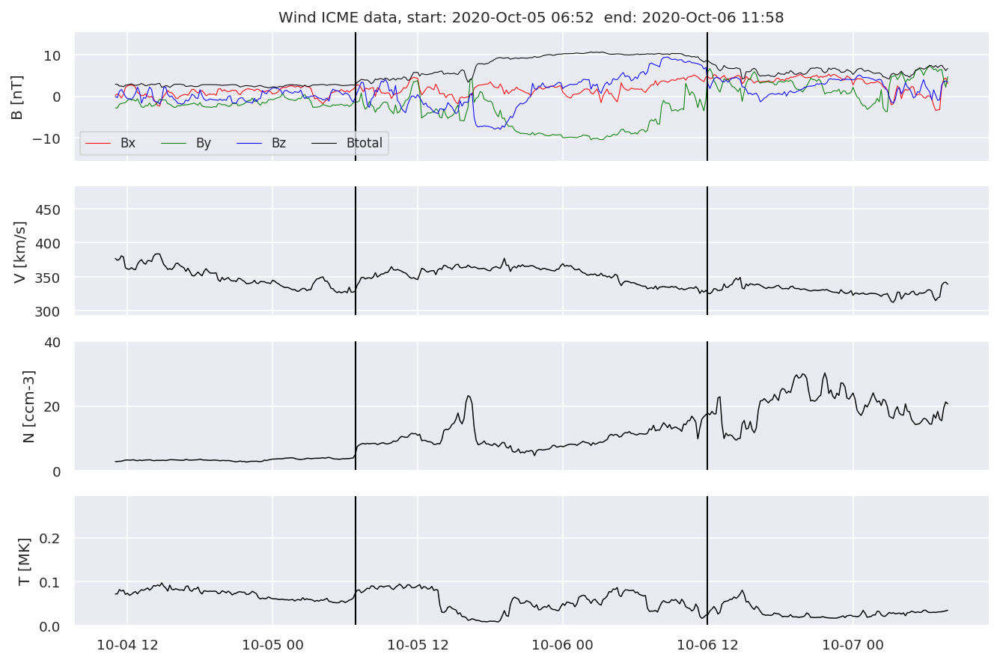

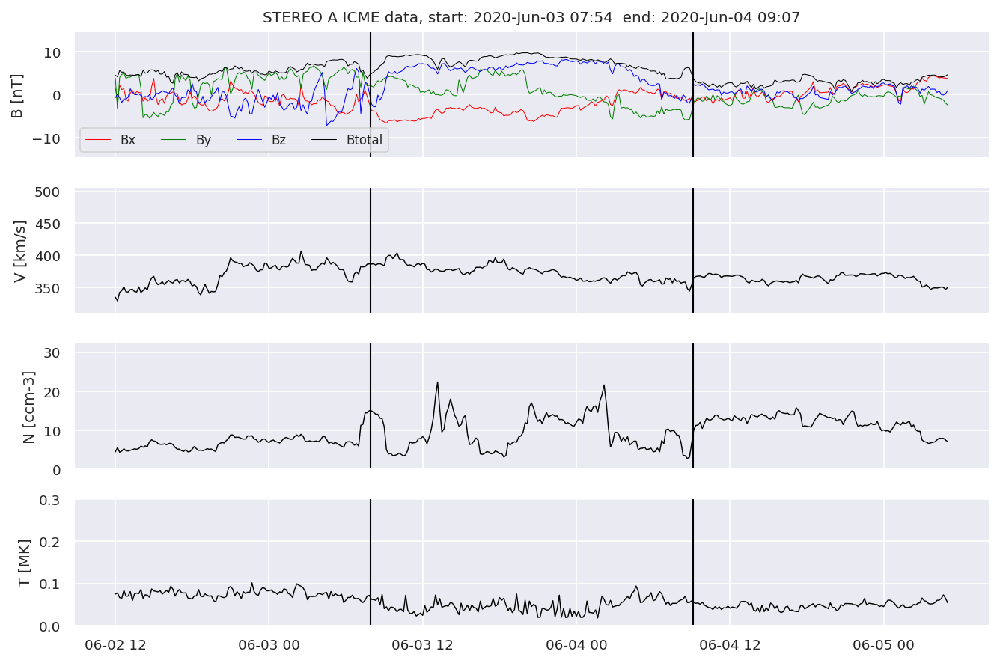

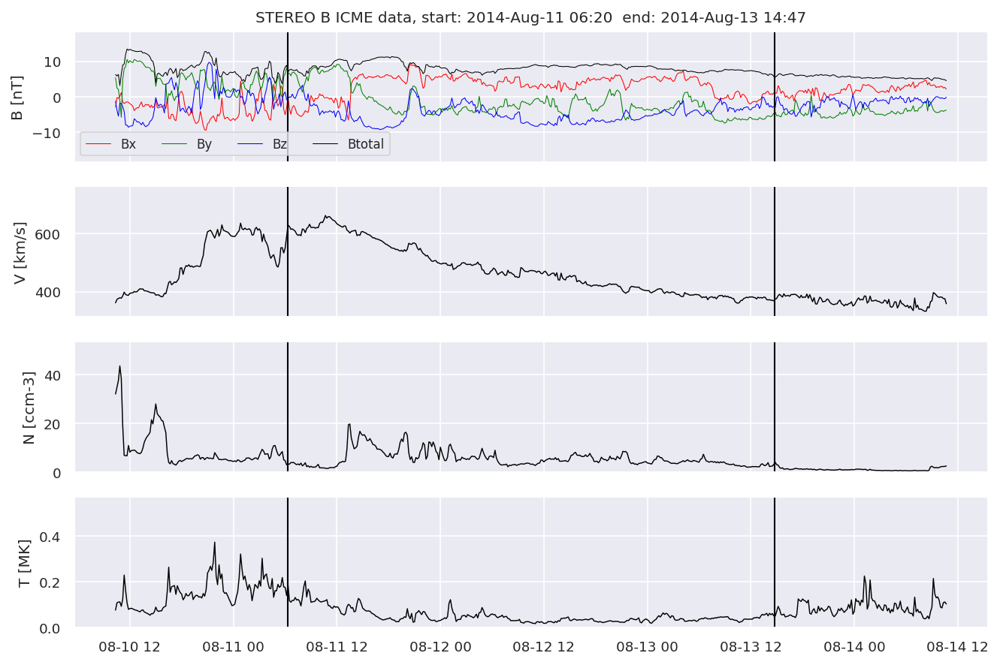

In [6]:
# plot example event for WIND

evtListw[0].iwfplotnopred(datawin, 20, 'Wind ')

# plot example event for STEREO A

evtLista[1].iwfplotnopred(dataa, 20, 'STEREO A ')

# plot example event for STEREO B

evtListb[2].iwfplotnopred(datab, 20, 'STEREO B ')

Looking at the WIND dataset we can see, that we now have 10 features:

- magnetic field and components
- velocity
- proton density
- proton temperature
- beta parameter
- dynamic pressure
- ratio between expected temperature and proton temperature

However, the values of these features vary in several orders of magnitude. Therefore, we'll perform scaling to set the mean value to 0 and the standard deviation to 1.

In [7]:
datawin

,bx,by,bz,bt,vt,np,tp,beta,Pdyn,texrat
2007-01-01 00:00:00,1.223244,-3.684057,0.080246,3.888975,331.939625,14.843064,19413.118748,0.646101,2.735598e-09,0.720593
2007-01-01 00:10:00,0.951300,-4.066096,0.060271,4.184126,330.122928,14.243541,18994.705795,0.536584,2.596340e-09,0.720648
2007-01-01 00:20:00,0.325078,-2.837958,0.867163,3.237512,328.747382,13.780732,25637.551120,1.314895,2.491679e-09,0.989950
2007-01-01 00:30:00,0.472819,-3.130698,2.199837,3.867082,327.870816,11.593735,24086.478532,0.654117,2.083827e-09,0.939926
2007-01-01 00:40:00,-0.159123,-1.394647,1.394927,2.462851,329.516427,12.122023,28034.909930,2.919348,2.202596e-09,1.073363
...,...,...,...,...,...,...,...,...,...,...
2021-04-28 23:10:00,-0.941782,1.187671,0.184250,1.526914,368.055969,4.161323,12093.222967,0.748976,9.428810e-10,0.303752
2021-04-28 23:20:00,-0.941784,1.187670,0.184250,1.526914,368.055969,4.161323,12093.222967,0.748976,9.428810e-10,0.303752
2021-04-28 23:30:00,-0.941785,1.187669,0.184249,1.526914,368.055969,4.161323,12093.222967,0.748976,9.428810e-10,0.303752
2021-04-28 23:40:00,-0.941786,1.187668,0.184248,1.526914,368.055969,4.161323,12093.222967,0.748976,9.428810e-10,0.303752


In [8]:
# perform scaling on WIND

scale = StandardScaler()
scale.fit(datawin)

wind_scaled = pds.DataFrame(index = datawin.index, columns = datawin.columns, data = scale.transform(datawin))

# perform scaling on STEREO A

scale = StandardScaler()
scale.fit(dataa)

sta_scaled = pds.DataFrame(index = dataa.index, columns = dataa.columns, data = scale.transform(dataa))

# perform scaling on STEREO B

scale = StandardScaler()
scale.fit(datab)

stb_scaled = pds.DataFrame(index = datab.index, columns = datab.columns, data = scale.transform(datab))

In [9]:
wind_scaled

,bx,by,bz,bt,vt,np,tp,beta,Pdyn,texrat
2007-01-01 00:00:00,0.406938,-1.064839,0.052577,-0.428195,-0.861950,1.652052,-0.819134,-0.076034,0.733165,-0.088519
2007-01-01 00:10:00,0.319958,-1.172525,0.045369,-0.313126,-0.880919,1.533749,-0.824326,-0.103581,0.634073,-0.088511
2007-01-01 00:20:00,0.119663,-0.826348,0.336545,-0.682178,-0.895282,1.442423,-0.741898,0.092189,0.559600,-0.050420
2007-01-01 00:30:00,0.166918,-0.908863,0.817456,-0.436731,-0.904435,1.010865,-0.761144,-0.074018,0.269385,-0.057496
2007-01-01 00:40:00,-0.035206,-0.419520,0.526995,-0.984191,-0.887252,1.115112,-0.712150,0.495760,0.353897,-0.038622
...,...,...,...,...,...,...,...,...,...,...
2021-04-28 23:10:00,-0.285537,0.308361,0.090108,-1.349080,-0.484834,-0.455766,-0.909964,-0.050158,-0.542478,-0.147478
2021-04-28 23:20:00,-0.285537,0.308361,0.090108,-1.349080,-0.484834,-0.455766,-0.909964,-0.050158,-0.542478,-0.147478
2021-04-28 23:30:00,-0.285538,0.308361,0.090108,-1.349080,-0.484834,-0.455766,-0.909964,-0.050158,-0.542478,-0.147478
2021-04-28 23:40:00,-0.285538,0.308361,0.090108,-1.349080,-0.484834,-0.455766,-0.909964,-0.050158,-0.542478,-0.147478


We derive the true label for each point in time, by comparing it to the list. 1 indicates that there is an ICME occurring at the moment, 0 indicates that there isn't.

In [10]:
import preprocess

truelabelw = pds.DataFrame(preprocess.get_truelabel(wind_scaled, evtListw))
truelabela = pds.DataFrame(preprocess.get_truelabel(sta_scaled, evtLista))
truelabelb = pds.DataFrame(preprocess.get_truelabel(stb_scaled, evtListb))

When we compare the number of events per year included in our catalogs, we can see variation due to the solar cycle. Therefore, randomly splitting the data into training, validation and testing will propably lead to a severe imbalance. Thus, we manually split into subsets to create different splits of data.

     WIND STEREOA STEREOB
2007    7       3       4
2008    5       5       8
2009   15       9      13
2010   15      13      16
2011   22      32      28
2012   30      36      33
2013   21      40      29
2014   15      29      17
2015   14       1       0
2016    9       6       0
2017   10      11       0
2018    8       5       0
2019    6      13       0
2020    8       2       0
2021    0       0       0


<Figure size 432x288 with 0 Axes>

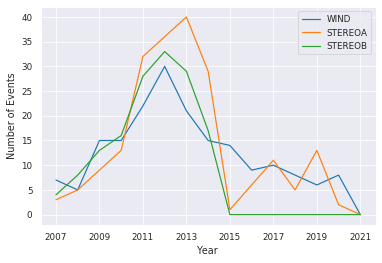

In [11]:
import preprocess

dicoflists = {'WIND': evtListw, 'STEREOA':evtLista, 'STEREOB':evtListb}
preprocess.compare_lists(dicoflists)

We have four different balanced splits to choose from. This gives us approximately the same number of events in each split. The function printpercentage shows us how much of the data is labeled positively. This percentage should be approximately equal over testing, validation and training.

In [12]:
split = 1
testw, valw, trainw = preprocess.getbalancedsplit(split, 'wind') 
testa, vala, traina = preprocess.getbalancedsplit(split, 'stereoa') 
testb, valb, trainb = preprocess.getbalancedsplit(split, 'stereob') 

X_testw, Y_testw, X_valw, Y_valw, X_trainw, Y_trainw = preprocess.getdatas(trainw,testw,valw,wind_scaled,truelabelw)
X_testa, Y_testa, X_vala, Y_vala, X_traina, Y_traina = preprocess.getdatas(traina,testa,vala,sta_scaled,truelabela)
X_testb, Y_testb, X_valb, Y_valb, X_trainb, Y_trainb = preprocess.getdatas(trainb,testb,valb,stb_scaled,truelabelb)


print(preprocess.printpercentage(Y_testw))
print(preprocess.printpercentage(Y_trainw))
print(preprocess.printpercentage(Y_valw))

label    0.052638
dtype: float64
label    0.046366
dtype: float64
label    0.043376
dtype: float64


To train the model on all datasets at once, we need to join them.

In [13]:
X_train = X_trainw.append(X_traina, sort=False)
X_train = X_train.append(X_trainb, sort = False)

Y_train = Y_trainw.append(Y_traina, sort=False)
Y_train = Y_train.append(Y_trainb, sort = False)

####

X_val = X_valw.append(X_vala, sort=False)
X_val = X_val.append(X_valb, sort = False)

Y_val = Y_valw.append(Y_vala, sort=False)
Y_val = Y_val.append(Y_valb, sort = False)

####

X_test = X_testw.append(X_testa, sort=False)
X_test = X_test.append(X_testb, sort = False)

Y_test = Y_testw.append(Y_testa, sort=False)
Y_test = Y_test.append(Y_testb, sort = False)

By now, we set up everything that we need for a machine learning pipeline. We preprocessed the data in a way, that is understandable for our algorithm. Additionally, we translated our desired output to a label, that fits the type of architecture we want. The area of computer vision is a very well researched field in machine learning. One specific subclass is semantic segmentation, used for example in medial image segmentation. A recent advance is the so called [ResUNet++](https://arxiv.org/pdf/1911.07067.pdf), used for polyp detection. Even though we deal with a different problem here, namely timeseries instead of images, some characteristics of the use cases are similar:

We need information of WHAT and WHERE! Therefore we choose an architecture, that resembles the [ResUNet++](https://arxiv.org/pdf/1911.07067.pdf).

### U-Net

- Consists of Downsampling, Upsampling and Concatenation
- Downsampling helps understand WHAT is the important information
- Upsampling and Concatenation keeps information of WHERE

### Residual Units

- Deeper = Better?
- vanishing/exploding gradient problem hinders optimization for deep CNNs
- shortcuts allow deeper networks while also reducing the computational cost

### Squeeze and Excitation Units

- improves channel interdependencies at almost no computational cost
- content aware mechanism to weight each channel adaptively

### Atrous Spatial Pyramidal Pooling

-  module for resampling a given feature layer at multiple rates prior to convolution

### Attention Units

- boosts performance and reduces computational cost
- determines which parts of the network require more attention

![Blockdiagram of our architecture](blockdiagram.jpg)

The next step is the setup of some parameters and the generators for training and validation. The Generator is based on the tensorflow sequence class, but generates windows in time of a specific size and their corresponding onedimensional "segmentation maps".

In [14]:
from metrics import dice_coef, dice_loss, true_skill_score
from unetgen import UnetGen
from cycliclr import *

model_path = "model"

## Parameters

C = 10 # number of channels
t = 1024 # window size
image_size = (t,1,C)
batch_size = 32
epochs =500
expclr = CyclicLR(base_lr=0.00001, max_lr=0.001, step_size=1000)

## Generator
train_gen = UnetGen(X_train, Y_train, length=int(t), stride = 120, batch_size=batch_size)
valid_gen = UnetGen(X_val, Y_val, length=int(t), stride = 120,batch_size=batch_size)

Next, we build the model and initiate some callbacks. We also select suitable metrics and start the training process:

In [15]:
from model import ResUnetPlusPlus

#### ResUnet++

arch = ResUnetPlusPlus(input_shape=image_size)
model = arch.build_model()

optimizer = Adam()

metrics = [Recall(), Precision(), dice_coef,true_skill_score, MeanIoU(num_classes=2)]
model.compile(loss=dice_loss, optimizer=optimizer, metrics=metrics) 

checkpoint = ModelCheckpoint(model_path, verbose=1, save_best_only=True)
early_stopping = EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)
callbacks = [checkpoint, early_stopping,expclr]


2021-12-05 23:44:52.346542: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1510] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 15405 MB memory:  -> device: 0, name: Tesla P100-PCIE-16GB, pci bus id: 0000:09:00.0, compute capability: 6.0


In [16]:
model.fit(train_gen,
          validation_data=valid_gen,
          epochs=epochs,
          callbacks=callbacks)

2021-12-05 20:16:30.846649: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:185] None of the MLIR Optimization Passes are enabled (registered 2)


Epoch 1/500


2021-12-05 20:16:35.886758: I tensorflow/stream_executor/cuda/cuda_dnn.cc:369] Loaded cuDNN version 8200


219/219 [==============================] - 130s 547ms/step - loss: 0.6775 - recall: 0.6023 - precision: 0.2377 - dice_coef: 0.3224 - true_skill_score: 0.6404 - mean_io_u: 0.5976 - val_loss: 0.7395 - val_recall: 0.4349 - val_precision: 0.5814 - val_dice_coef: 0.2604 - val_true_skill_score: 0.5735 - val_mean_io_u: 0.6313

Epoch 00001: val_loss improved from inf to 0.73945, saving model to model


2021-12-05 20:18:46.940977: W tensorflow/python/util/util.cc:348] Sets are not currently considered sequences, but this may change in the future, so consider avoiding using them.


INFO:tensorflow:Assets written to: model/assets
Epoch 2/500
219/219 [==============================] - 113s 515ms/step - loss: 0.6057 - recall: 0.5582 - precision: 0.4073 - dice_coef: 0.3943 - true_skill_score: 0.7000 - mean_io_u: 0.6238 - val_loss: 0.7049 - val_recall: 0.6780 - val_precision: 0.3404 - val_dice_coef: 0.2965 - val_true_skill_score: 0.6990 - val_mean_io_u: 0.6196

Epoch 00002: val_loss improved from 0.73945 to 0.70488, saving model to model
INFO:tensorflow:Assets written to: model/assets
Epoch 3/500
219/219 [==============================] - 113s 515ms/step - loss: 0.6073 - recall: 0.5296 - precision: 0.4191 - dice_coef: 0.3927 - true_skill_score: 0.6808 - mean_io_u: 0.6240 - val_loss: 0.7181 - val_recall: 0.8018 - val_precision: 0.2674 - val_dice_coef: 0.2835 - val_true_skill_score: 0.7271 - val_mean_io_u: 0.5782

Epoch 00003: val_loss did not improve from 0.70488
Epoch 4/500
219/219 [==============================] - 113s 515ms/step - loss: 0.6136 - recall: 0.5354 - pr


Epoch 00021: val_loss did not improve from 0.45511
Epoch 22/500
219/219 [==============================] - 113s 514ms/step - loss: 0.5233 - recall: 0.6048 - precision: 0.5554 - dice_coef: 0.4767 - true_skill_score: 0.7422 - mean_io_u: 0.6791 - val_loss: 0.5684 - val_recall: 0.5652 - val_precision: 0.5347 - val_dice_coef: 0.4318 - val_true_skill_score: 0.6585 - val_mean_io_u: 0.6683

Epoch 00022: val_loss did not improve from 0.45511
Epoch 23/500
219/219 [==============================] - 113s 515ms/step - loss: 0.5954 - recall: 0.5149 - precision: 0.4576 - dice_coef: 0.4047 - true_skill_score: 0.6747 - mean_io_u: 0.6319 - val_loss: 0.7225 - val_recall: 0.6667 - val_precision: 0.3095 - val_dice_coef: 0.2777 - val_true_skill_score: 0.6603 - val_mean_io_u: 0.6110

Epoch 00023: val_loss did not improve from 0.45511
Epoch 24/500
219/219 [==============================] - 113s 514ms/step - loss: 0.5702 - recall: 0.5628 - precision: 0.4956 - dice_coef: 0.4298 - true_skill_score: 0.7211 - mea

After the training process is finished, we continue by testing our model on unseen data:

In [16]:
import postprocess
from glob import glob

batch_size = 1


## Model
with CustomObjectScope({'dice_loss': dice_loss, 'dice_coef': dice_coef, 'true_skill_score': true_skill_score}):
    model = load_model(model_path)

# TEST WIND

test_genw = UnetGen(X_testw, Y_testw, length=int(t), stride = int(t),batch_size=batch_size)

model.evaluate(test_genw, verbose=1)

resultw = postprocess.generate_result(X_testw, Y_testw, model,C,t)

# TEST STEREO A

test_gena = UnetGen(X_testa, Y_testa, length=int(t), stride = int(t),batch_size=batch_size)

model.evaluate(test_gena, verbose=1)

resulta = postprocess.generate_result(X_testa, Y_testa, model,C,t)

# TEST STEREO B

test_genb = UnetGen(X_testb, Y_testb, length=int(t), stride = int(t),batch_size=batch_size)

model.evaluate(test_genb, verbose=1)

resultb = postprocess.generate_result(X_testb, Y_testb, model,C,t)

2021-12-05 23:44:59.467293: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:185] None of the MLIR Optimization Passes are enabled (registered 2)
2021-12-05 23:45:01.187044: I tensorflow/stream_executor/cuda/cuda_dnn.cc:369] Loaded cuDNN version 8200


151/151 [==============================] - 6s 24ms/step - loss: 0.1881 - recall: 0.6126 - precision: 0.6893 - dice_coef: 0.8119 - true_skill_score: 0.8451 - mean_io_u: 0.7166


100%|█████████████████████████████████████████| 151/151 [00:12<00:00, 11.96it/s]


108/108 [==============================] - 3s 24ms/step - loss: 0.2628 - recall: 0.4913 - precision: 0.7317 - dice_coef: 0.7372 - true_skill_score: 0.7299 - mean_io_u: 0.6717


100%|█████████████████████████████████████████| 108/108 [00:08<00:00, 12.25it/s]


90/90 [==============================] - 2s 23ms/step - loss: 0.2455 - recall: 0.4734 - precision: 0.7061 - dice_coef: 0.7545 - true_skill_score: 0.7714 - mean_io_u: 0.6590


100%|███████████████████████████████████████████| 90/90 [00:07<00:00, 12.49it/s]


We use the following metrics to evaluate our model:

#### Precision

percentage of true ICMEs predicted by the algorithm out of all predicted 

- True Positives/(True Positives + False Positives)

#### Recall 

percentage of true ICMEs predicted by the algorithm out of all true

- True Positives/(True Positives + False Negatives)

#### Mean IoU

- True Positives/(True Positives + False Negatives + False Positives)

#### Dice Coefficient

- 2 x Intersection/Union

#### True Skill Score 

- True Positives/(True Positives + False Negatives) - False Positives/(False Positives + True Negatives)

To get a better feeling for the performance in terms of detection rate, we first need to convert our onedimensional segmentation map to a list of events:

In [17]:
# evaluate WIND

resultw.index = pds.to_datetime(resultw.index)
resultbinw = postprocess.make_binary(resultw['pred'], 0.5)
eventsw = postprocess.makeEventList(resultbinw, 1, 10)
ICMEsw = postprocess.removeCreepy(eventsw, 3)
test_cloudsw = [x for x in evtListw if (x.begin.year in testw)]

# evaluate STEREO A

resulta.index = pds.to_datetime(resulta.index)
resultbina = postprocess.make_binary(resulta['pred'], 0.5)
eventsa = postprocess.makeEventList(resultbina, 1, 10)
ICMEsa = postprocess.removeCreepy(eventsa, 3)
test_cloudsa = [x for x in evtLista if (x.begin.year in testa)]

# evaluate STEREO B

resultb.index = pds.to_datetime(resultb.index)
resultbinb = postprocess.make_binary(resultb['pred'], 0.5)
eventsb = postprocess.makeEventList(resultbinb, 1, 10)
ICMEsb = postprocess.removeCreepy(eventsb, 3)
test_cloudsb = [x for x in evtListb if (x.begin.year in testb)]

We can then plot the events and their associated similarity values to compare true label to predicted label.

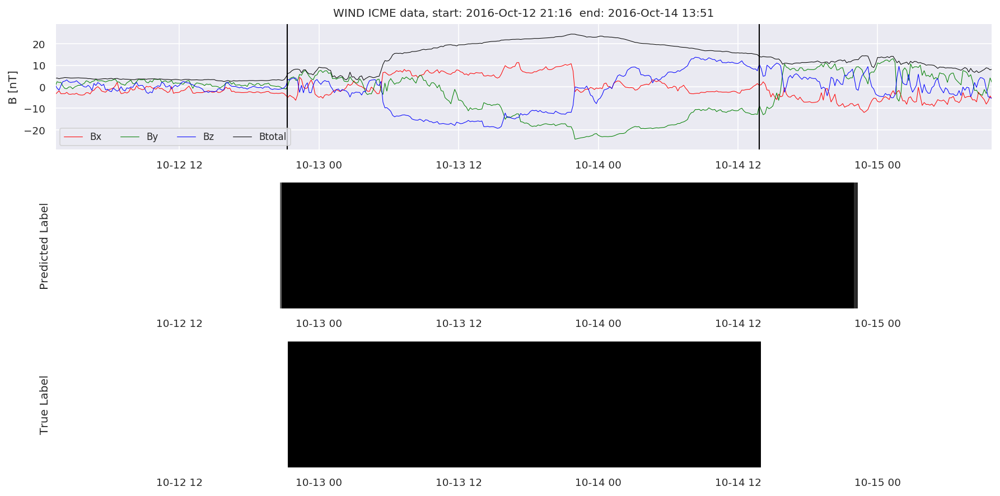

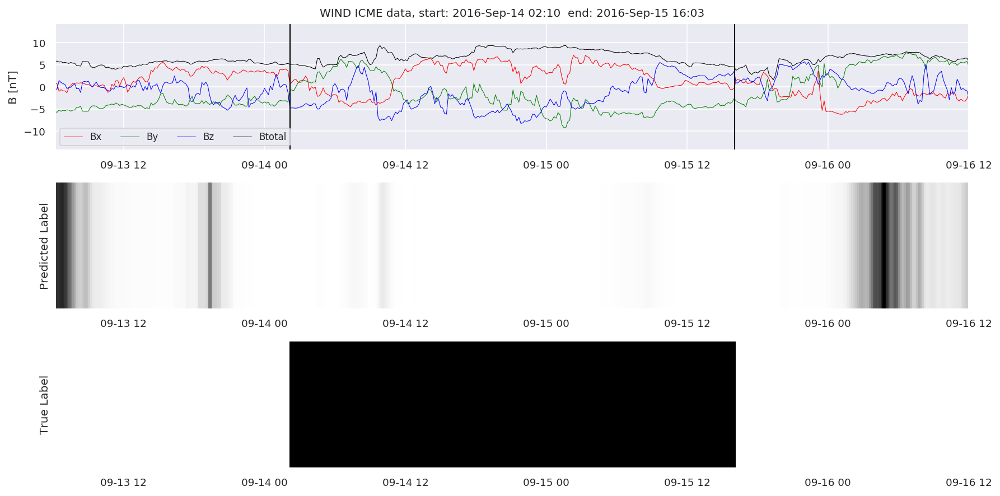

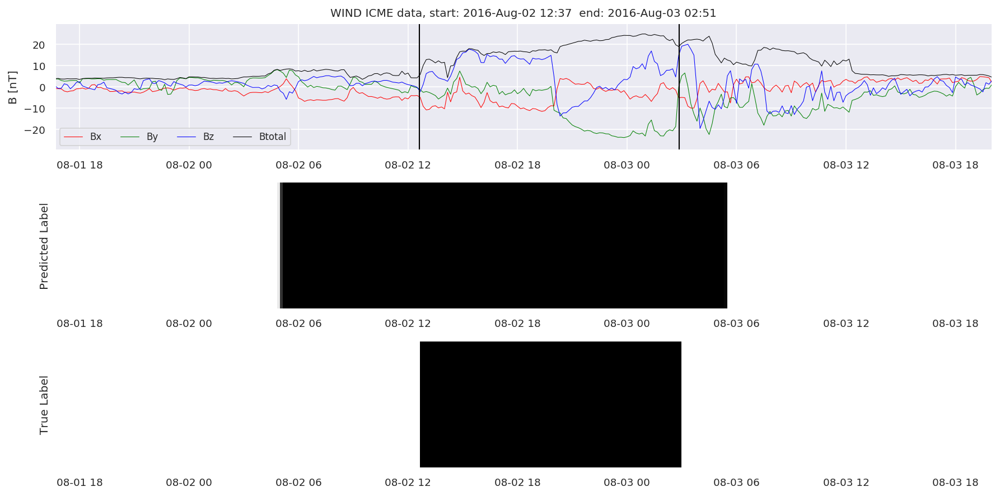

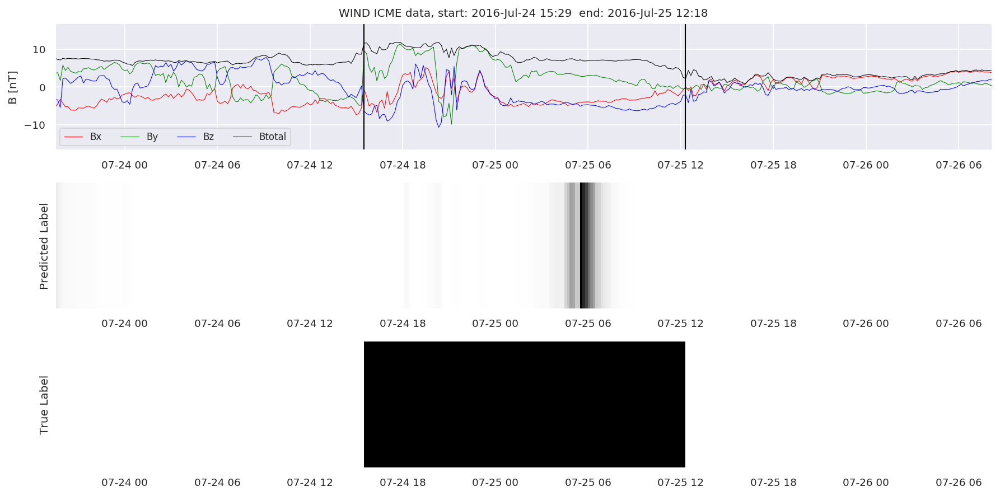

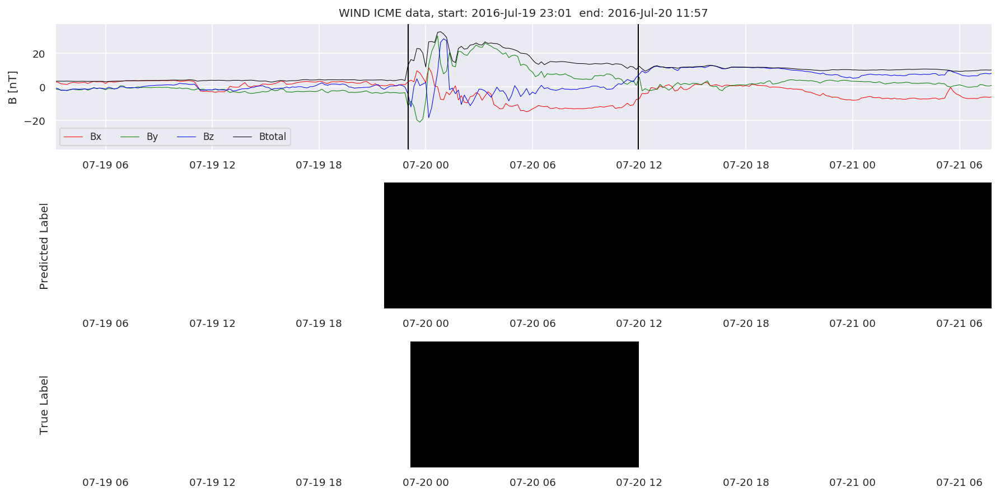

...

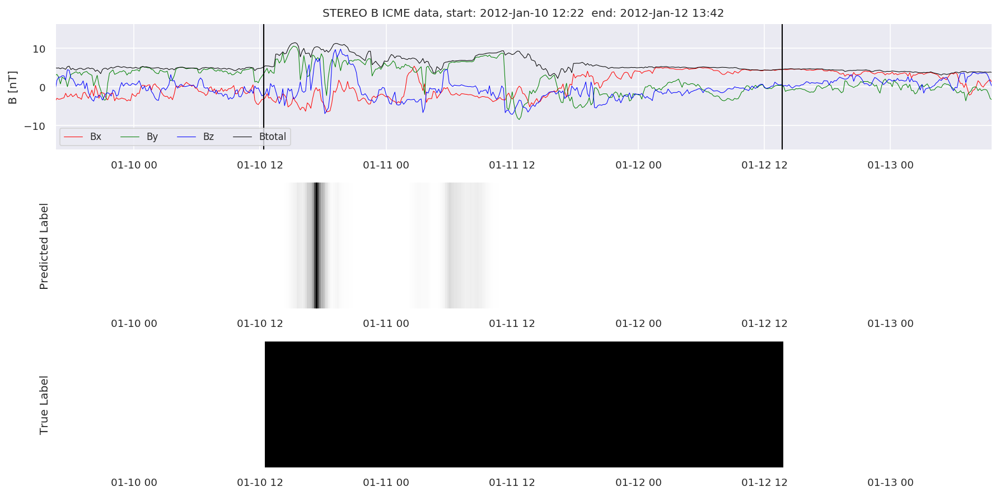

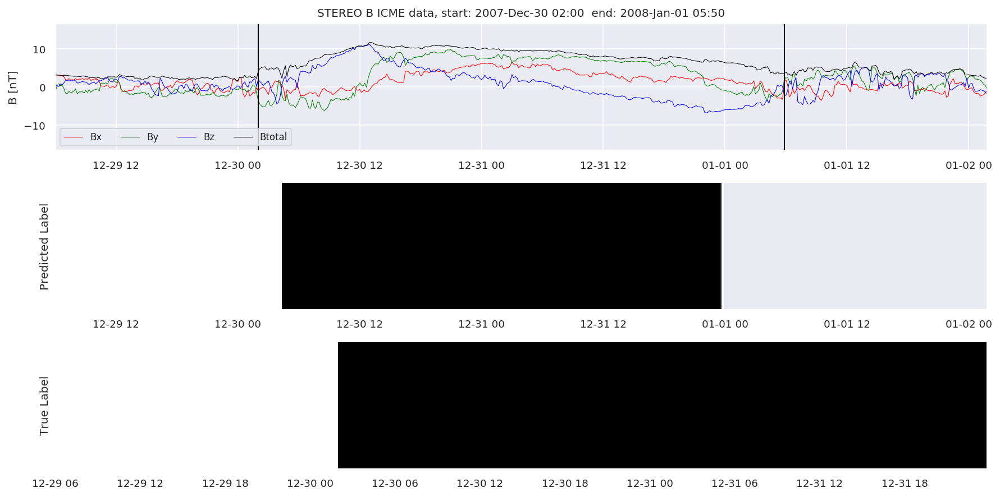

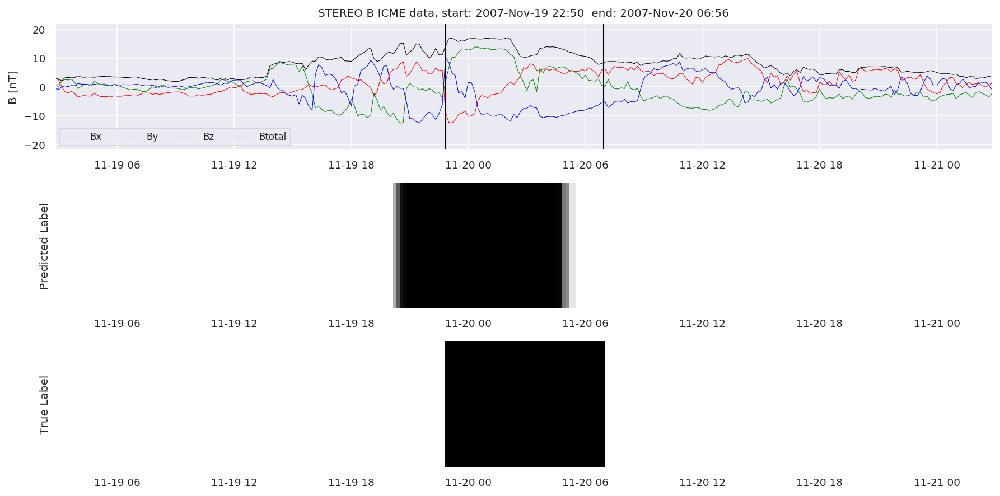

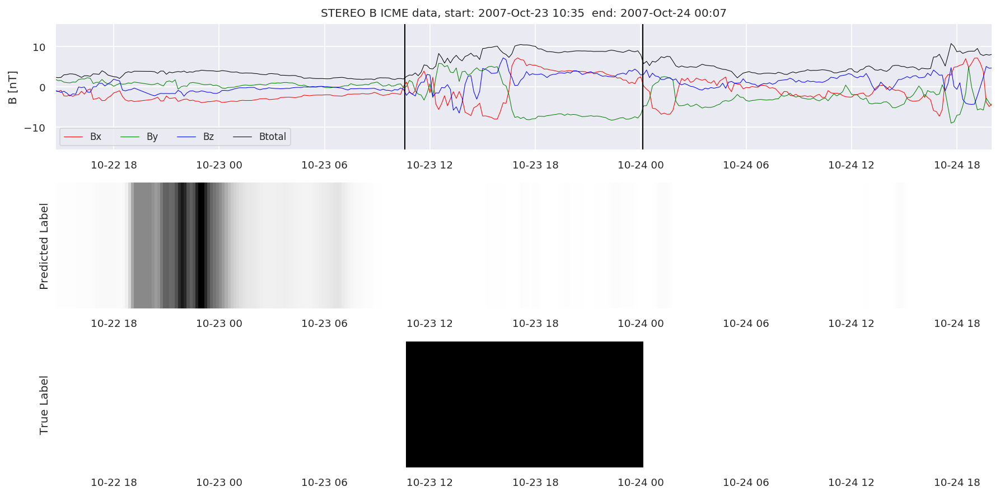

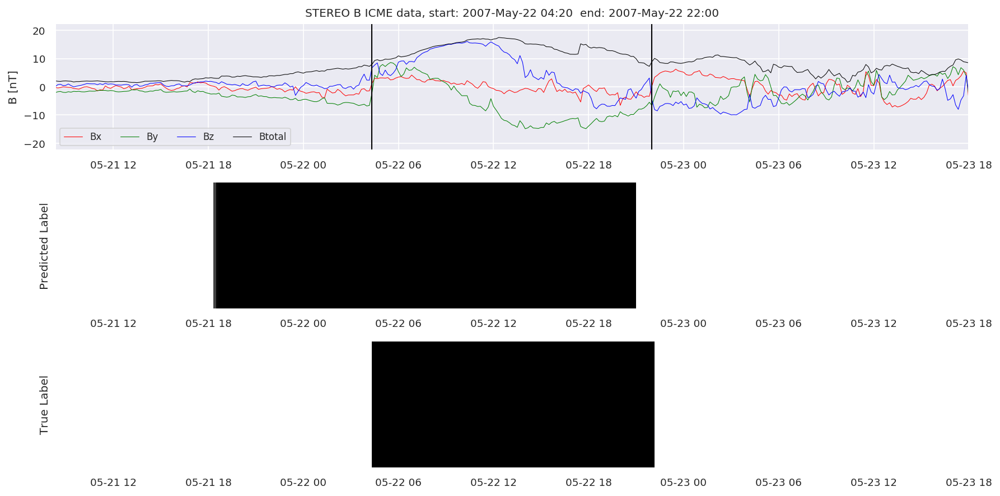

In [23]:
#Plot events and associated similarity values

for i in range(0, len(test_cloudsw)):
    test_cloudsw[i].plot_similaritymap(datawin,20,i,'WIND ',resultw)
    
for i in range(0, len(test_cloudsa)):
    test_cloudsa[i].plot_similaritymap(dataa,20,i,'STEREO A ',resulta)
    
for i in range(0, len(test_cloudsb)):
    test_cloudsb[i].plot_similaritymap(datab,20,i,'STEREO B ',resultb)

Finally, we compare the true eventlist to the eventlists the model predicted.

In [19]:
# Score by event WIND

print('WIND:')

TPw, FNw, FPw, detectedw = postprocess.evaluate(ICMEsw, test_cloudsw, thres=0.1)
print('Precision is:',len(TPw)/(len(TPw)+len(FPw)))
print('Recall is:',len(TPw)/(len(TPw)+len(FNw)))
print('True Positives', len(TPw))
print('False Negatives', len(FNw))
print('False Positives', len(FPw))

# Score by event STEREO A

print('---------------------')

print('STEREO A:')

TPa, FNa, FPa, detecteda = postprocess.evaluate(ICMEsa, test_cloudsa, thres=0.1)
print('Precision is:',len(TPa)/(len(TPa)+len(FPa)))
print('Recall is:',len(TPa)/(len(TPa)+len(FNa)))
print('True Positives', len(TPa))
print('False Negatives', len(FNa))
print('False Positives', len(FPa))

# Score by event STEREO B

print('---------------------')

print('STEREO B:')

TPb, FNb, FPb, detectedb = postprocess.evaluate(ICMEsb, test_cloudsb, thres=0.1)
print('Precision is:',len(TPb)/(len(TPb)+len(FPb)))
print('Recall is:',len(TPb)/(len(TPb)+len(FNb)))
print('True Positives', len(TPb))
print('False Negatives', len(FNb))
print('False Positives', len(FPb))

WIND:
Precision is: 0.6829268292682927
Recall is: 0.6363636363636364
True Positives 28
False Negatives 16
False Positives 13
---------------------
STEREO A:
Precision is: 0.7105263157894737
Recall is: 0.54
True Positives 27
False Negatives 23
False Positives 11
---------------------
STEREO B:
Precision is: 0.7586206896551724
Recall is: 0.5945945945945946
True Positives 22
False Negatives 15
False Positives 7


We can see, that even though there's room for improvement, the results of our pipeline are reasonable given the fact, that the problem is quite complicated. Some of the False Positives might even be structures that are actually similar to ICMEs.

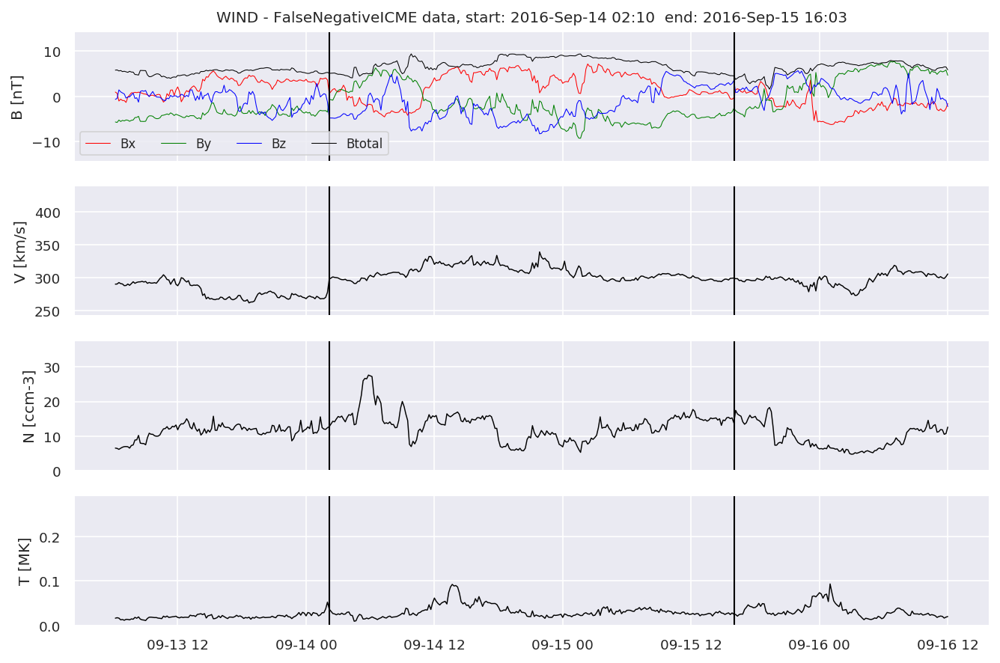

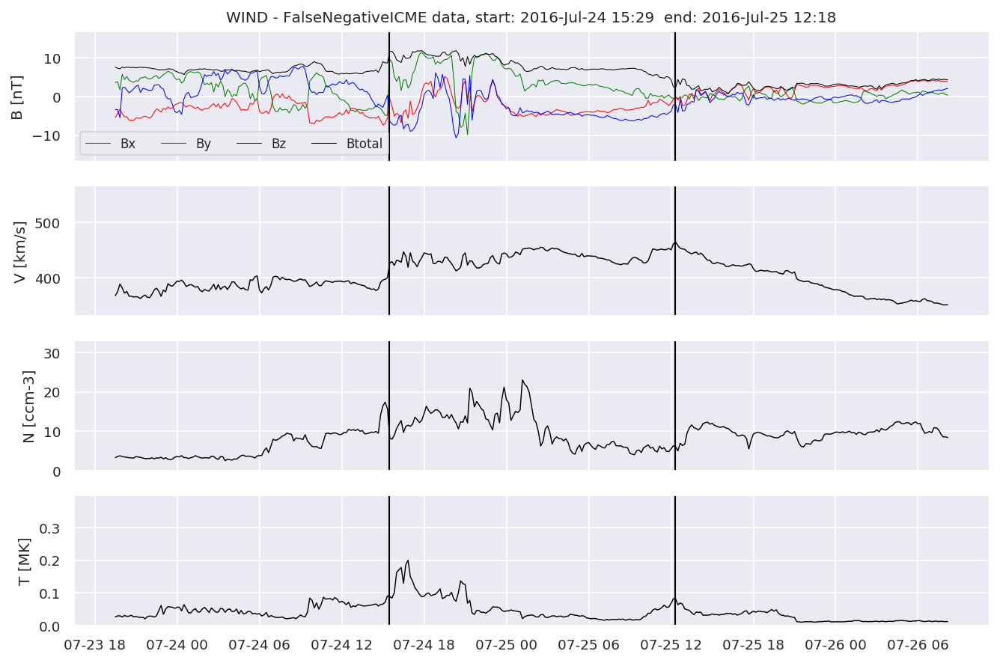

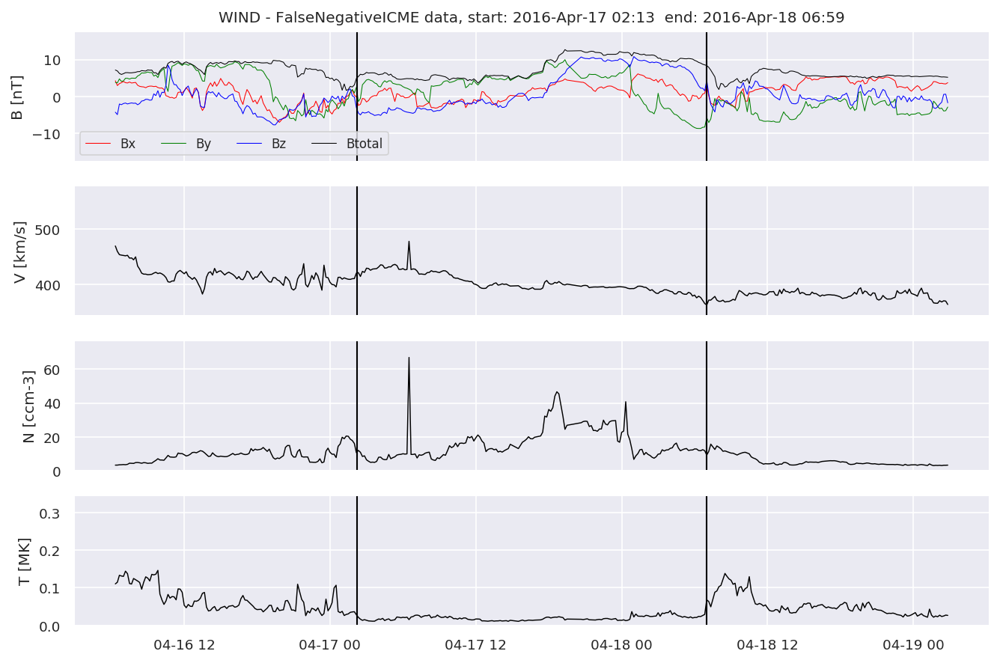

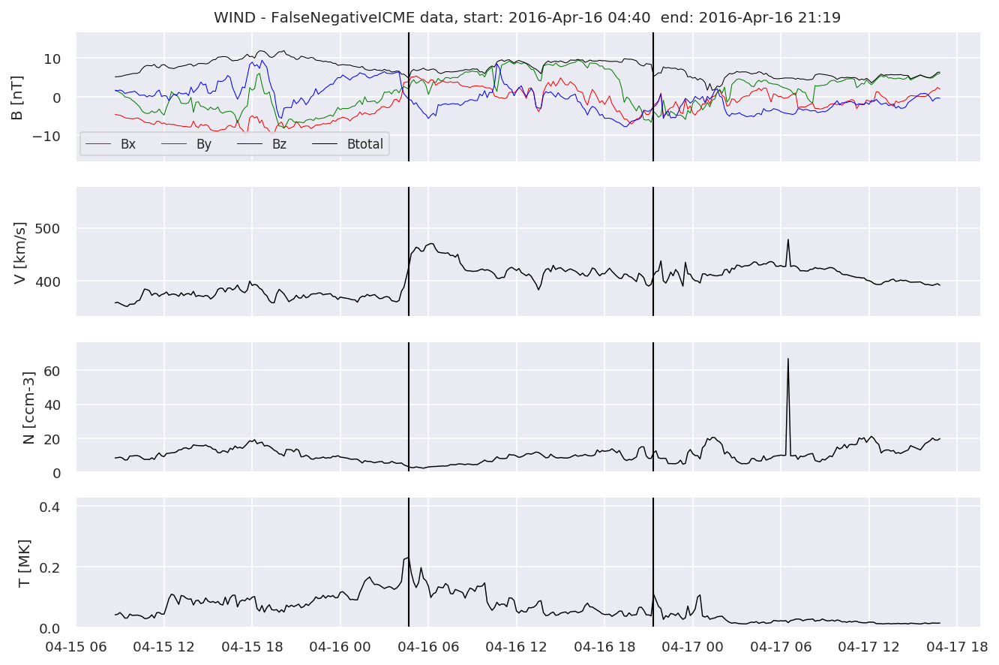

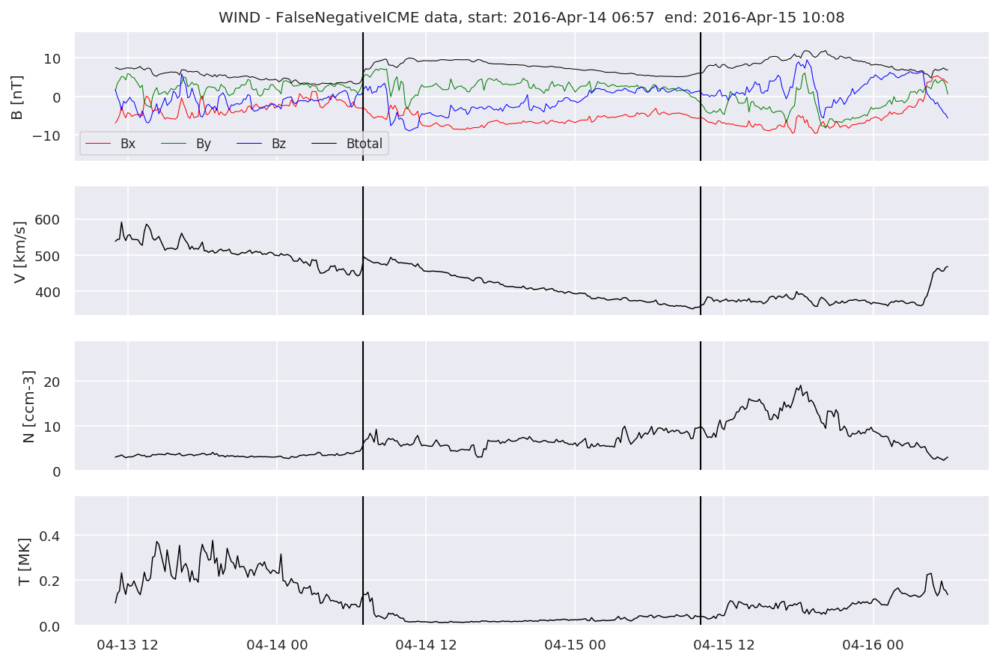

...

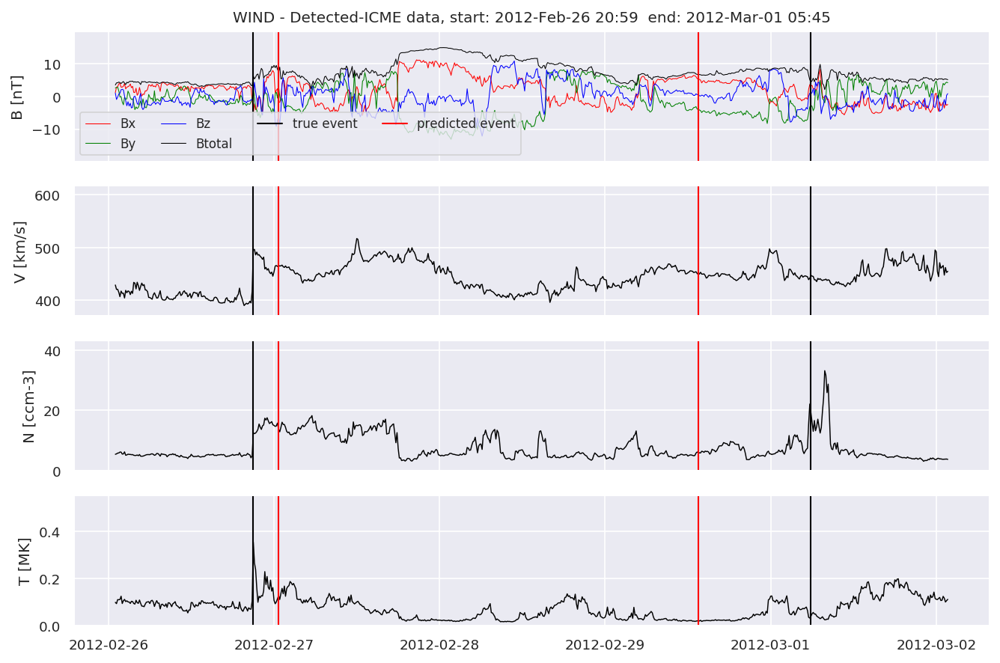

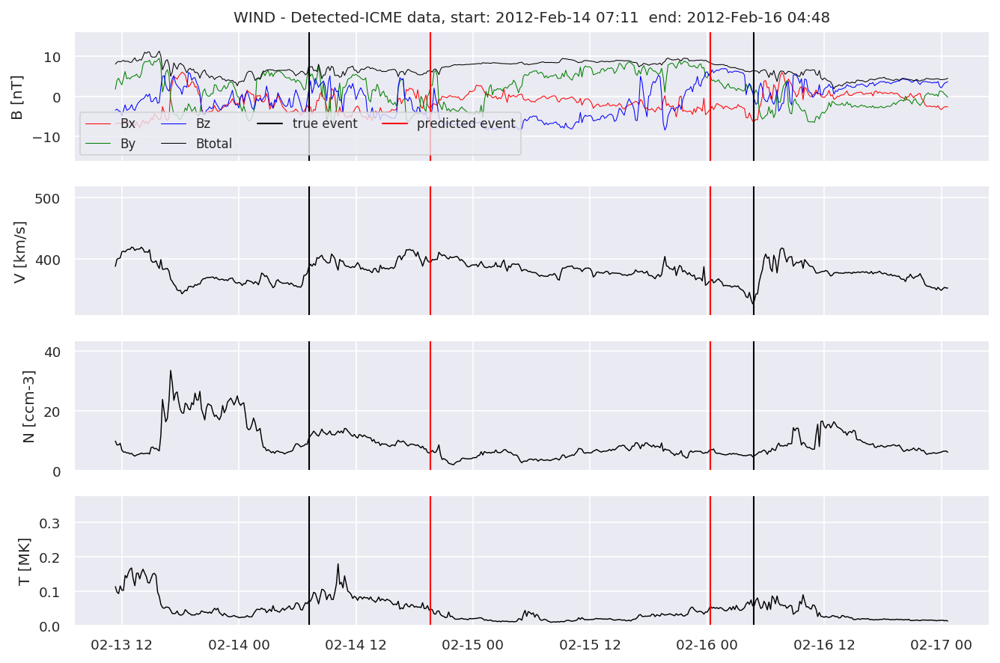

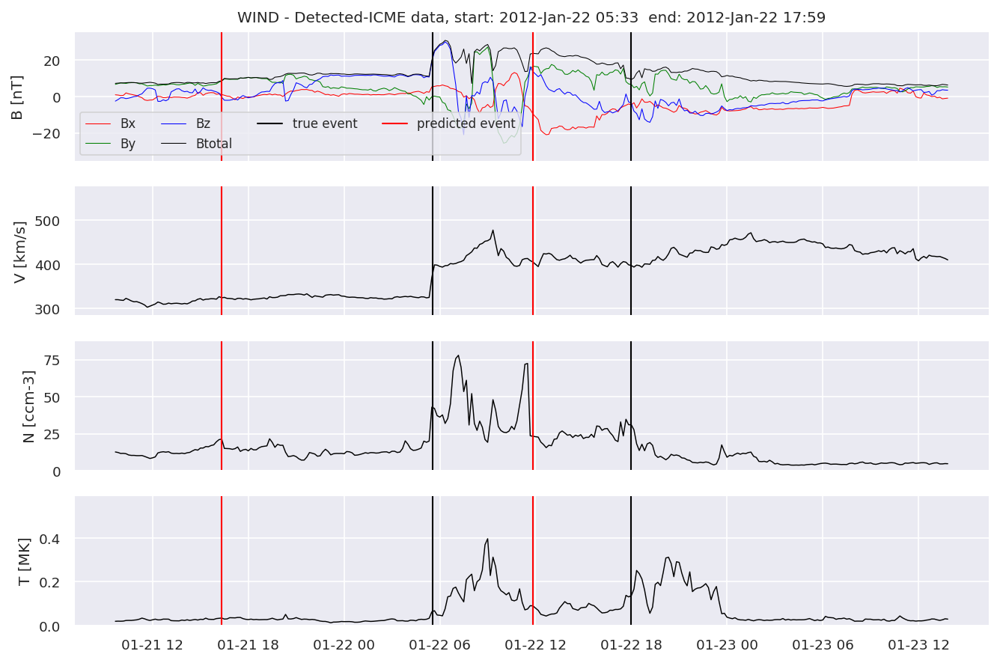

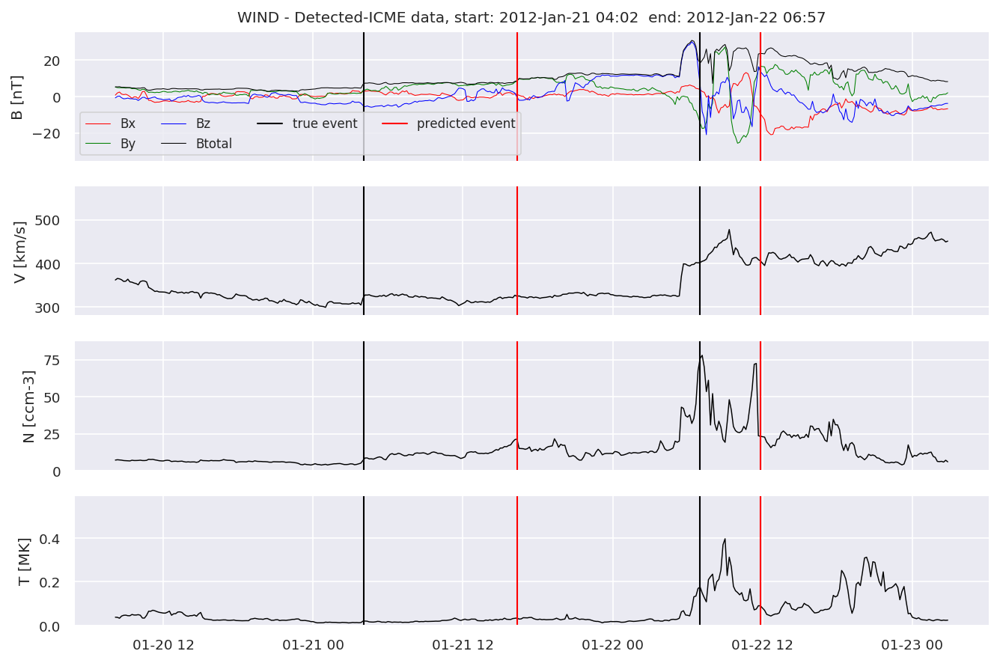

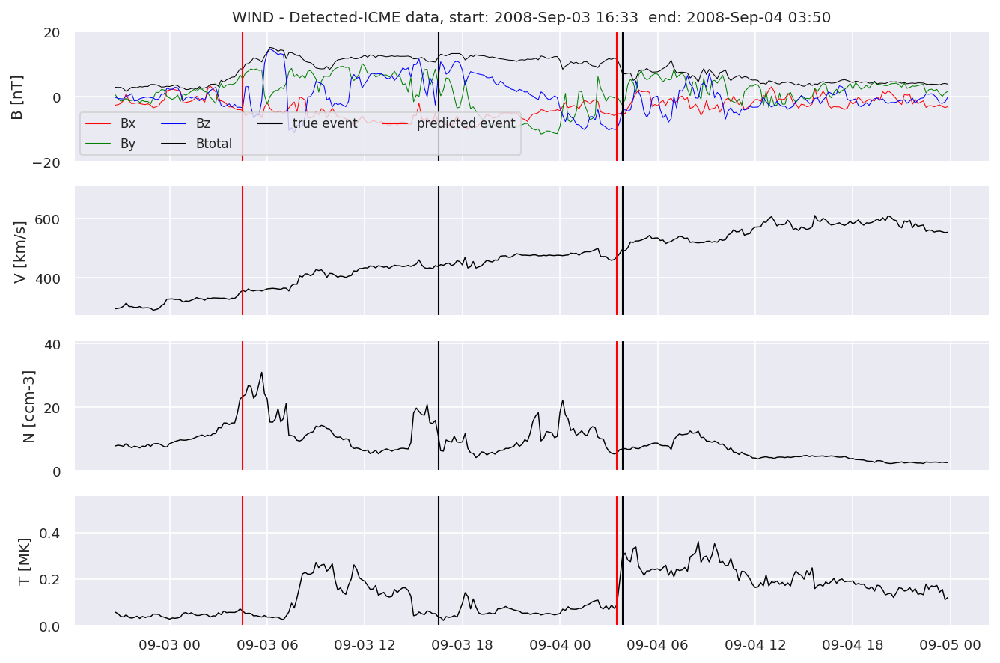

In [24]:
#Plot FNs, FPs and Detected events

for i in range(0, len(FNw)):
    
    FNw[i].iwfplotnopred(datawin, 20, 'WIND - FalseNegative')
    
for i in range(0, len(FPw)):
    
    FPw[i].iwfplotnopred(datawin, 20, 'WIND - FalsePositive')
    
    
for i in range(0, len(detectedw)):
    predstart = TPw[i].begin
    predend = TPw[i].end
    detectedw[i].iwfplot(datawin, 20, i, 'WIND - Detected-', predstart, predend)

for i in range(0, len(FNa)):
    
    FNa[i].iwfplotnopred(dataa, 20, 'STEREO A - FalseNegative')
    
for i in range(0, len(FPa)):
    
    FPa[i].iwfplotnopred(dataa, 20, 'STEREO A - FalsePositive')
    
    
for i in range(0, len(detecteda)):
    predstart = TPa[i].begin
    predend = TPa[i].end
    detecteda[i].iwfplot(dataa, 20, i, 'STEREO A - Detected-', predstart, predend)

for i in range(0, len(FNb)):
    
    FNb[i].iwfplotnopred(datab, 20, 'STEREO B - FalseNegative')
    
for i in range(0, len(FPb)):
    
    FPb[i].iwfplotnopred(datab, 20, 'STEREO B - FalsePositive')
    
    
for i in range(0, len(detectedb)):
    predstart = TPb[i].begin
    predend = TPb[i].end
    detectedb[i].iwfplot(datab, 20, i, 'STEREO B - Detected-', predstart, predend)

Last but not least, we plot two well-known evaluation metrics:

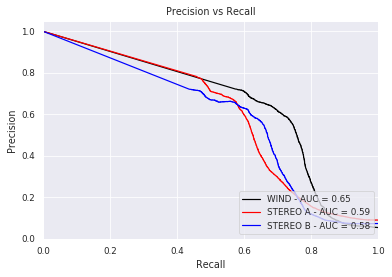

In [27]:
from sklearn.metrics import precision_recall_curve, auc, plot_precision_recall_curve


# calculate precision-recall curve
precisionw, recallw, thresholdsw = precision_recall_curve(resultw['true'], resultw['pred'])
pr_aucw = auc(recallw, precisionw)

precisiona, recalla, thresholdsa = precision_recall_curve(resulta['true'], resulta['pred'])
pr_auca = auc(recalla, precisiona)

precisionb, recallb, thresholdsb = precision_recall_curve(resultb['true'], resultb['pred'])
pr_aucb = auc(recallb, precisionb)

plt.figure()
plt.title('Precision vs Recall')
plt.plot(recallw, precisionw, 'k', label = 'WIND - AUC = %0.2f' % pr_aucw)
plt.plot(recalla, precisiona, 'r', label = 'STEREO A - AUC = %0.2f' % pr_auca)
plt.plot(recallb, precisionb, 'b', label = 'STEREO B - AUC = %0.2f' % pr_aucb)
plt.legend(loc = 'lower right')
plt.xlim([0, 1])
plt.ylim([0, 1.05])
plt.ylabel('Precision')
plt.xlabel('Recall')
plt.show()   

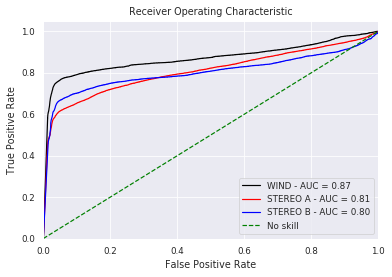

In [28]:
from sklearn.metrics import roc_curve, roc_auc_score

# calculate roc curve

fprw, tprw, thresholdsw = roc_curve(resultw['true'], resultw['pred'])
fpra, tpra, thresholdsa = roc_curve(resulta['true'], resulta['pred'])
fprb, tprb, thresholdsb = roc_curve(resultb['true'], resultb['pred'])

auc_rocw = roc_auc_score(resultw['true'], resultw['pred'])
auc_roca = roc_auc_score(resulta['true'], resulta['pred'])
auc_rocb = roc_auc_score(resultb['true'], resultb['pred'])


plt.title('Receiver Operating Characteristic')
plt.plot(fprw, tprw, 'k', label = 'WIND - AUC = %0.2f' % auc_rocw)
plt.plot(fpra, tpra, 'r', label = 'STEREO A - AUC = %0.2f' % auc_roca)
plt.plot(fprb, tprb, 'b', label = 'STEREO B - AUC = %0.2f' % auc_rocb)
plt.plot([0, 1], [0, 1],'g--',label = 'No skill')
plt.legend(loc = 'lower right')
plt.xlim([0, 1])
plt.ylim([0, 1.05])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()  